# Color Image Quantization
Reduce the number of colors in images (`lena.png`, `peppers.tif`) to 16 using K-means clustering, implemented from scratch. Log L2 norms per iteration and optionally visualize quantized images.

In [10]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [11]:
def kmeans_quantization(image, k=16, max_iterations=100, visualize=False, log_file="L2_norm_log.txt"):
    """
    Perform K-means color quantization on an image.

    Args:
        image: Input image (H, W, 3) as float32 in [0, 1].
        k: Number of clusters (colors).
        max_iterations: Maximum number of iterations.
        visualize: If True, display quantized image per iteration.
        log_file: File path to save L2 norms.

    Returns:
        quantized_image: Image with k colors.
        l2_norms: List of L2 norms per iteration.
    """
    # 1. Reshape image to list of pixels (N, 3)
    h, w, c = image.shape
    pixels = image.reshape(-1, 3)

    # 2. Initialize k centroids randomly from pixels
    np.random.seed(42)
    indices = np.random.choice(pixels.shape[0], k, replace=False)
    centroids = pixels[indices]

    l2_norms = []

    for it in range(max_iterations):
        # 3. Assign pixels to nearest centroid (L2 norm)
        distances = np.sqrt(((pixels[:, None, :] - centroids[None, :, :]) ** 2).sum(axis=2))
        labels = np.argmin(distances, axis=1)

        # 4. Update centroids as mean of assigned pixels
        new_centroids = np.array([pixels[labels == j].mean(axis=0) if np.any(labels == j) else centroids[j] for j in range(k)])

        # 5. Compute L2 norm between old and new centroids
        l2_norm = np.linalg.norm(new_centroids - centroids)
        l2_norms.append(l2_norm)

        # Log iteration result
        with open(log_file, "a") as f:
            f.write(f"Iteration {it+1}: L2 norm = {l2_norm:.6f}\n")

        centroids = new_centroids

        # 6. Visualization if enabled
        if visualize:
            quantized_pixels = centroids[labels]
            quantized_image = quantized_pixels.reshape(h, w, c)
            plt.imshow(quantized_image)
            plt.title(f"Iteration {it+1}")
            plt.axis("off")
            plt.show()

        # Convergence check
        if l2_norm < 1e-5:
            break

    # Final reconstruction
    quantized_pixels = centroids[labels]
    quantized_image = quantized_pixels.reshape(h, w, c)

    return quantized_image, l2_norms

In [12]:
def calculate_l2_norm(original, quantized):
    """
    Calculate total L2 norm between original and quantized images.

    Args:
        original: Original image (H, W, 3) as float32 in [0, 1].
        quantized: Quantized image (H, W, 3) as float32 in [0, 1].

    Returns:
        l2_norm: Total L2 norm across all pixels.
    """
    diff = (original - quantized) ** 2
    l2_norm = np.sqrt(np.sum(diff))
    return l2_norm

In [13]:
# Load images
lena_path = '/content/lena.png'

lena = cv2.imread(lena_path).astype(np.float32) / 255.0

# Parameters
k = 16
max_iterations = 100
visualize = True

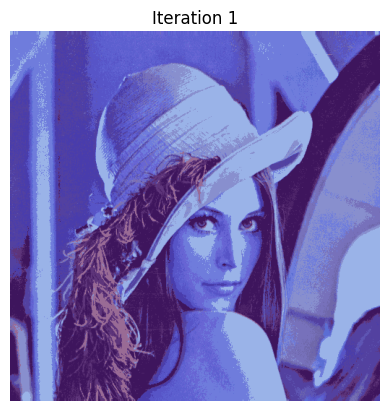

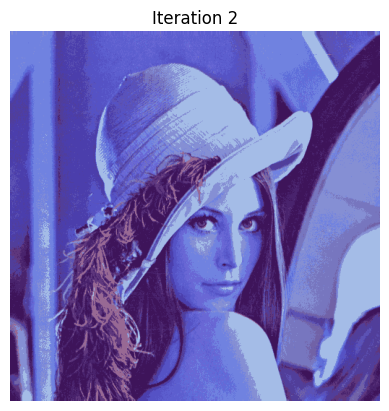

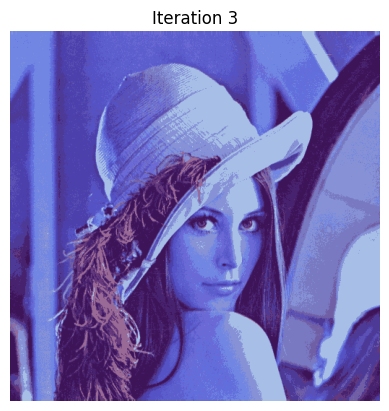

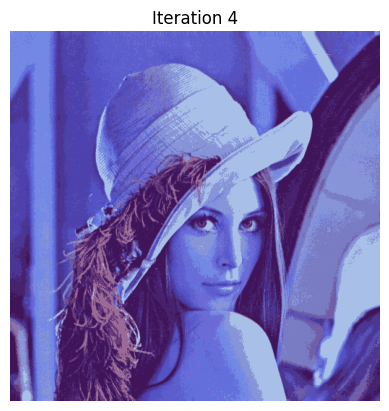

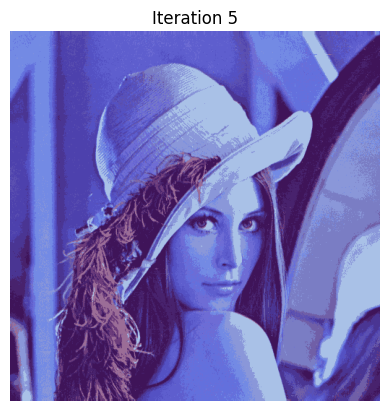

...

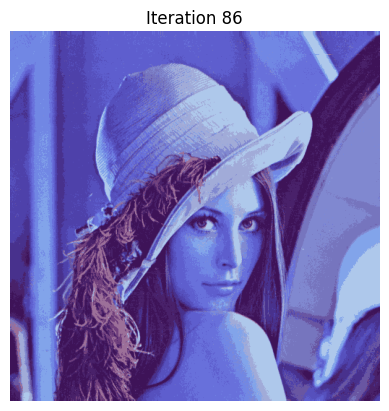

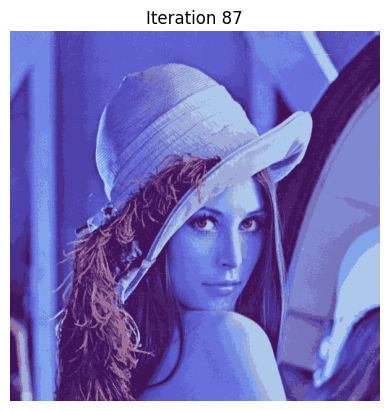

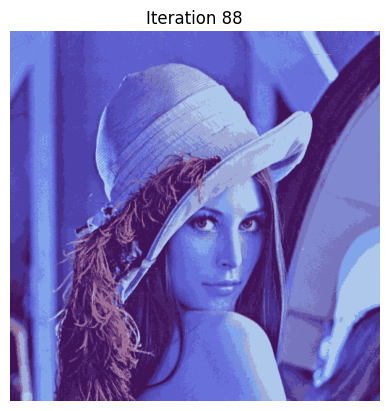

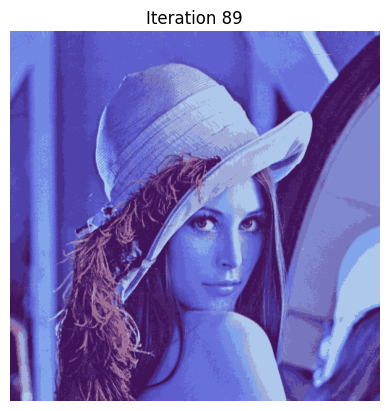

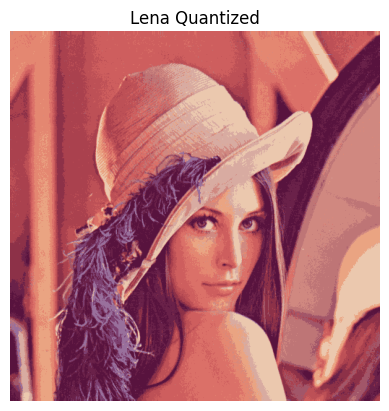

Total L2 Norm: 29.56


True

In [14]:
# Process images
lena_quantized, lena_l2_norms = kmeans_quantization(lena, k, max_iterations, visualize)

# Save L2 norms
with open('L2_norm_log.txt', 'w') as f:
    f.write('Lena L2 Norms:\n' + '\n'.join(map(str, lena_l2_norms)) + '\n')

# Calculate final L2 norms
lena_l2 = calculate_l2_norm(lena, lena_quantized)

# Visualize results
plt.imshow(cv2.cvtColor(lena_quantized, cv2.COLOR_BGR2RGB))
plt.title('Lena Quantized')
plt.axis('off')
plt.show()

print(f'Total L2 Norm: {lena_l2:.2f}')

# Save quantized images
cv2.imwrite('lena_quantized.png', (lena_quantized * 255).astype(np.uint8))